In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns

# --------------------------------------------------------------
# Load data
# --------------------------------------------------------------
df = pd.read_pickle("../../data/interim/01_data_processed.pkl")
df.head()

,acc_x,acc_y,acc_z,gyro_x,gyro_y,gyro_z,participant,excercise,intensity,ind
epoch (ms),,,,,,,,,,
2019-01-11 15:08:05.200,0.013500,0.977000,-0.071000,-1.8904,2.4392,0.9388,B,bench,heavy1,30
2019-01-11 15:08:05.400,-0.001500,0.970500,-0.079500,-1.6826,-0.8904,2.1708,B,bench,heavy1,30
2019-01-11 15:08:05.600,0.001333,0.971667,-0.064333,2.5608,-0.2560,-1.4146,B,bench,heavy1,30
2019-01-11 15:08:05.800,-0.024000,0.957000,-0.073500,8.0610,-4.5244,-2.0730,B,bench,heavy1,30
2019-01-11 15:08:06.000,-0.028000,0.957667,-0.115000,2.4390,-1.5486,-3.6098,B,bench,heavy1,30


In [3]:
# Make uniform labels for heavy and medium intensities
df.intensity.value_counts()

medium      3082
heavy       2262
medium1      713
standing     600
heavy2       591
sitting      510
medium2      344
heavy1       322
medium3      298
heavy3       287
Name: intensity, dtype: int64

In [4]:
df["intensity"] = df.intensity.replace(regex = {r"medium.*": "medium", r"heavy.*": "heavy"})

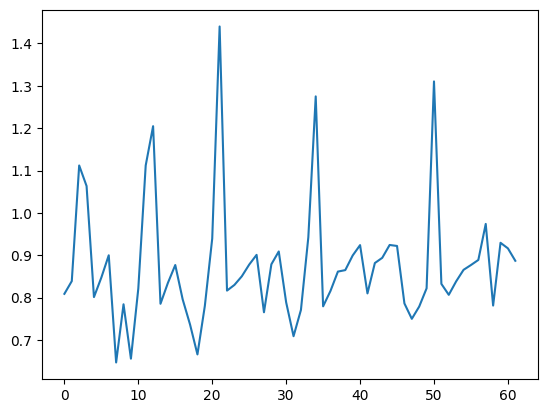

In [8]:
# --------------------------------------------------------------
# Plot single columns
# --------------------------------------------------------------
df_set_1 = df[df["ind"] == 2]
plt.plot(df_set_1["acc_y"].reset_index(drop = True)) # Resetting the index allows us to look at the sample numbers instead of time labels which is more informative in this case

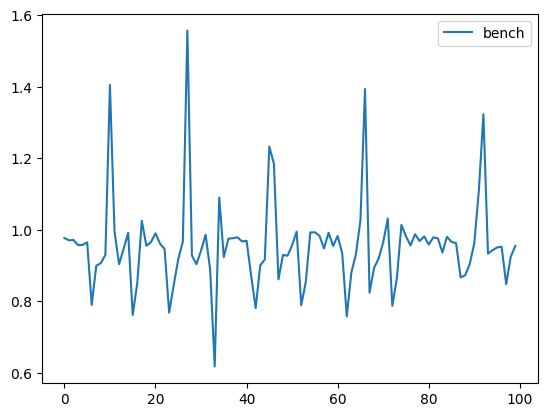

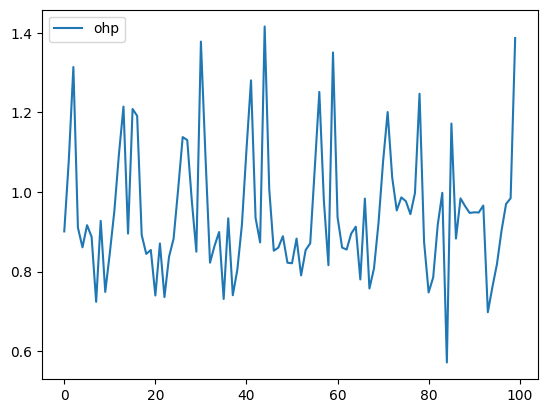

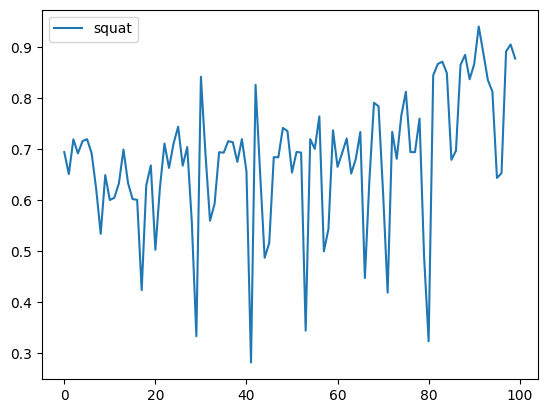

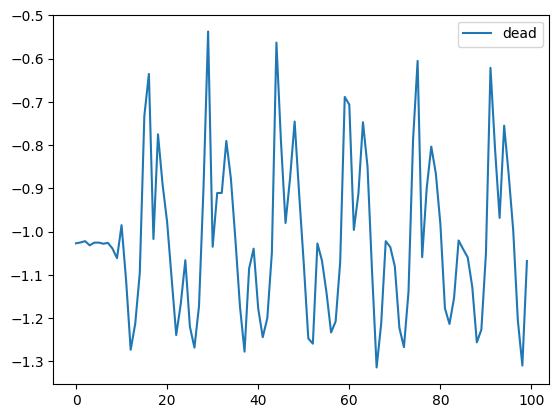

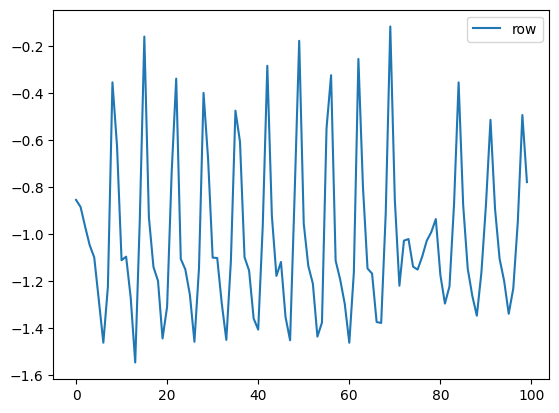

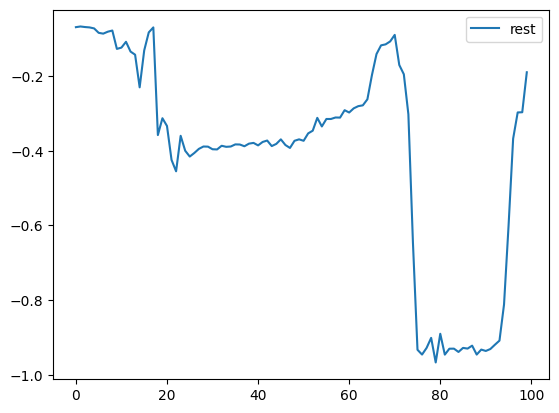

In [9]:
# --------------------------------------------------------------
# Plot all exercises
# --------------------------------------------------------------
labels = df.excercise.unique() # Provides the names of all excercises

for label in labels:
  subset = df[df.excercise == label]
  fig, ax = plt.subplots()
  plt.plot(subset[:100]["acc_y"].reset_index(drop = True), label = label)
  plt.legend()
  plt.show()

In [10]:
# --------------------------------------------------------------
# Adjust plot settings
# --------------------------------------------------------------
mpl.style.use("seaborn-v0_8-deep")
mpl.rcParams["figure.figsize"] = (20, 5)
mpl.rcParams["figure.dpi"] = 100

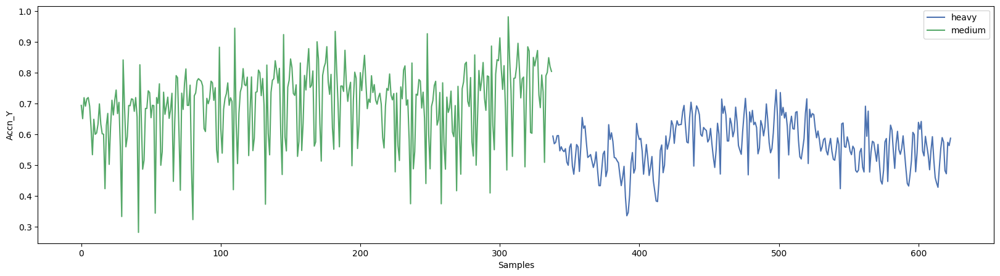

In [11]:
# --------------------------------------------------------------
# Compare medium vs. heavy sets
# --------------------------------------------------------------
category_df = df.query("excercise == 'squat'").query("participant == 'A'").reset_index()
fig, ax = plt.subplots()
category_df.groupby("intensity").acc_y.plot()
plt.xlabel("Samples")
plt.ylabel("Accn_Y")
plt.legend()
plt.show()

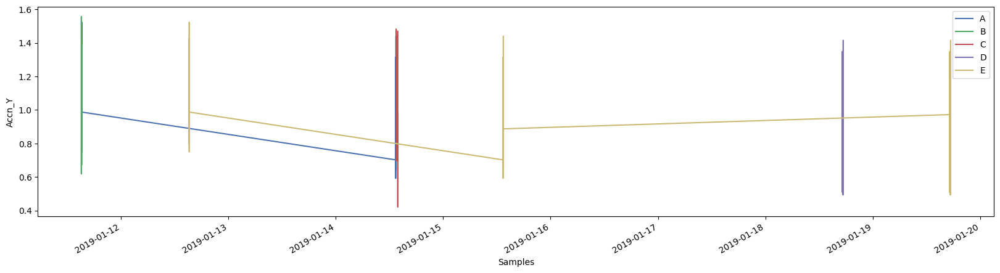

In [12]:
# --------------------------------------------------------------
# Compare participants
# --------------------------------------------------------------
participants_df = df.query("excercise == 'bench'").sort_values("participant")
fig, ax = plt.subplots()
participants_df.groupby("participant").acc_y.plot()
plt.xlabel("Samples")
plt.ylabel("Accn_Y")
plt.legend()
plt.show()

Here, we see cannot see anything in terms of the data that we are interested in, i.e. acc_y as the time index, 'epoch (ms)' between the sets performed by participants takes up most of the figure. A way to visualize it better is to reset the index. 

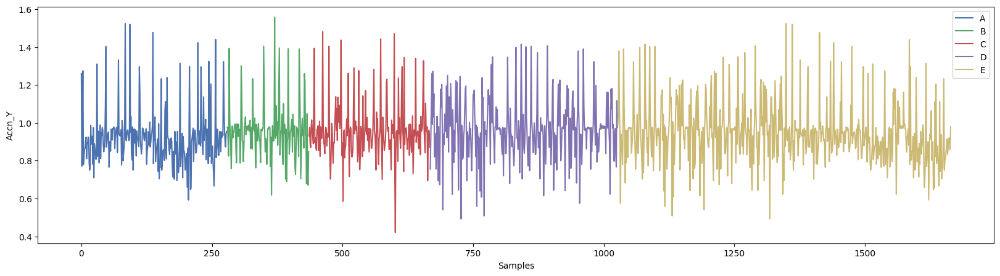

In [13]:
participants_df = df.query("excercise == 'bench'").sort_values("participant").reset_index() 
fig, ax = plt.subplots()
participants_df.groupby("participant").acc_y.plot() # Gruop bench press by participants and label it to compare.
plt.xlabel("Samples")
plt.ylabel("Accn_Y")
plt.legend()
plt.show()

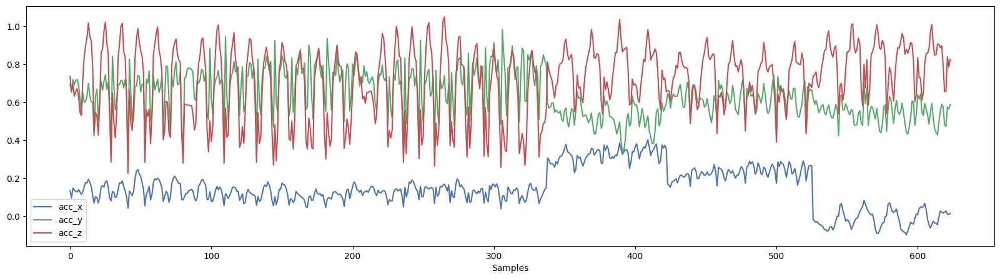

In [14]:
# --------------------------------------------------------------
# Plot multiple axis
# --------------------------------------------------------------
excercise = "squat"
participant = "A"

query_df = df.query(f"excercise == '{excercise}'").query(f"participant =='{participant}'").reset_index()
query_df[["acc_x","acc_y","acc_z"]].plot()
plt.xlabel("Samples")
plt.legend()
plt.show()

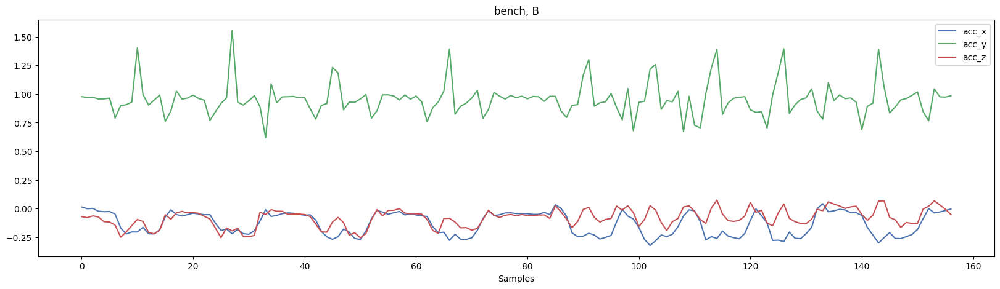

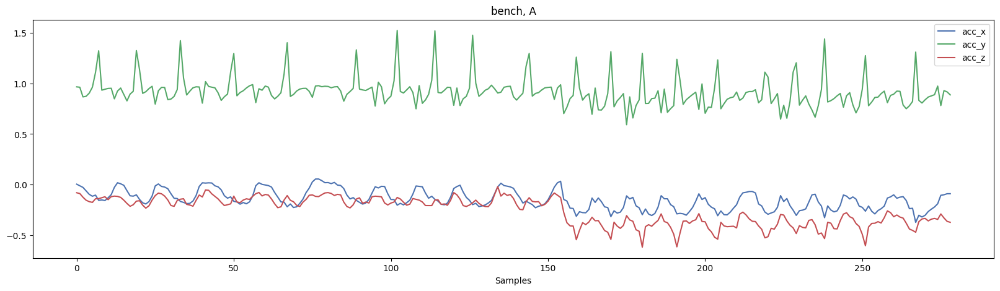

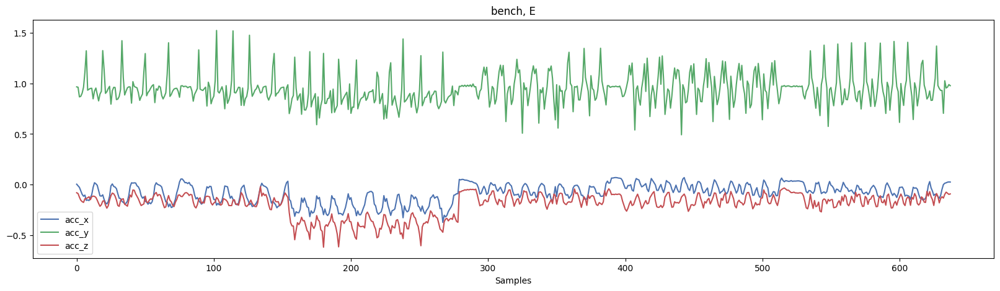

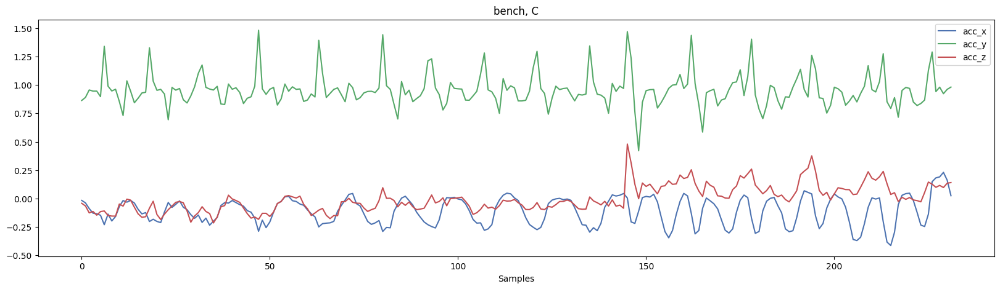

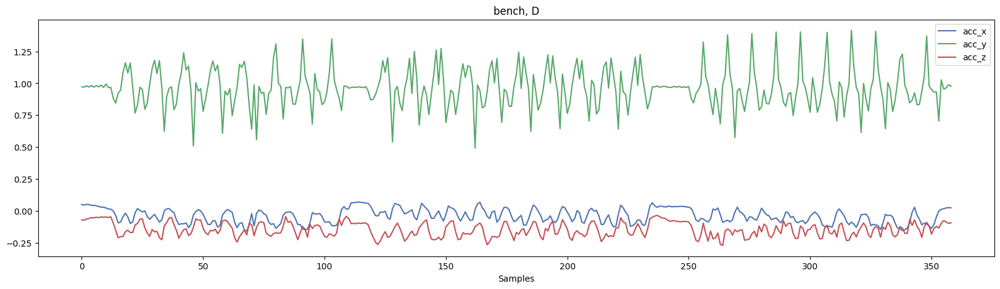

...

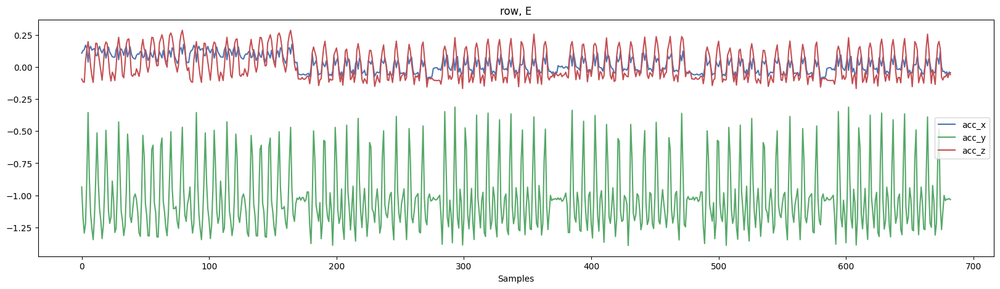

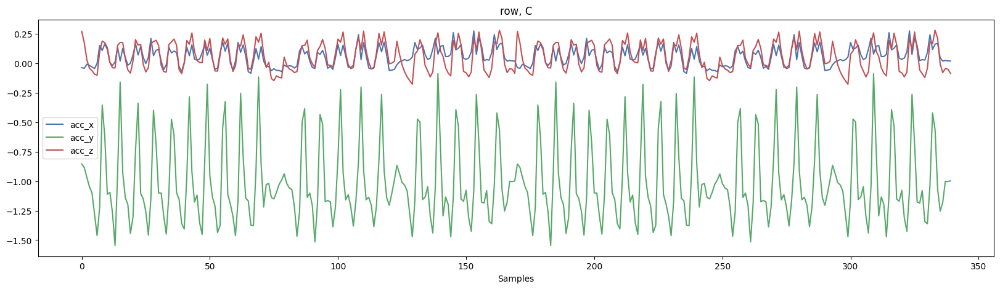

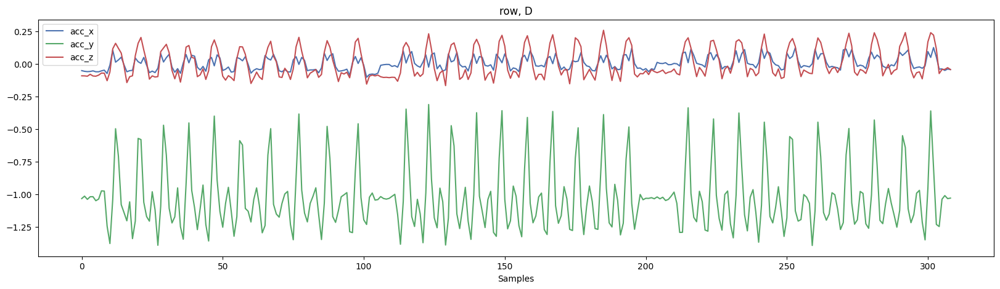

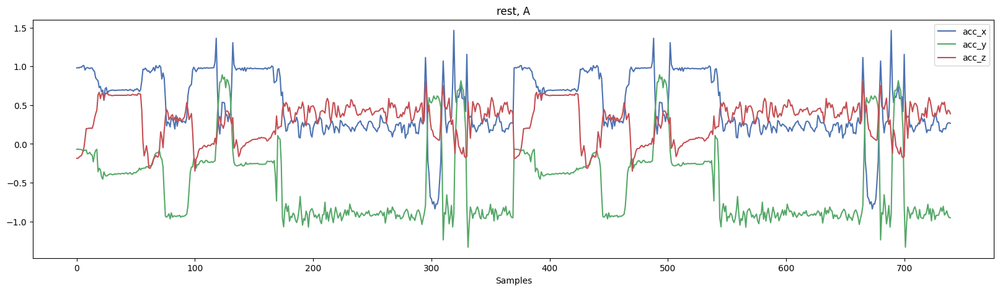

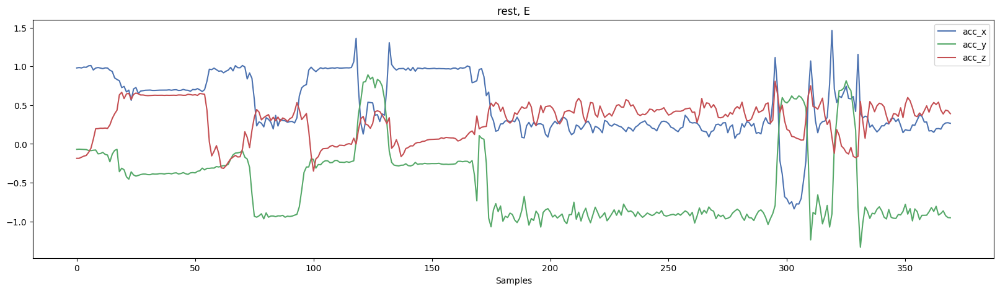

In [15]:
# --------------------------------------------------------------
# Create a loop to plot all combinations per sensor
# --------------------------------------------------------------
excercises = df.excercise.unique()
participants = df.participant.unique()

for excercise in excercises:
  for participant in participants:
    query_df = df.query(f"excercise == '{excercise}'").query(f"participant =='{participant}'").reset_index()
    if len(query_df) > 0:
      query_df[["acc_x","acc_y","acc_z"]].plot()
      plt.xlabel("Samples")
      plt.legend()
      plt.title(f"{excercise}, {participant}")
      plt.show()

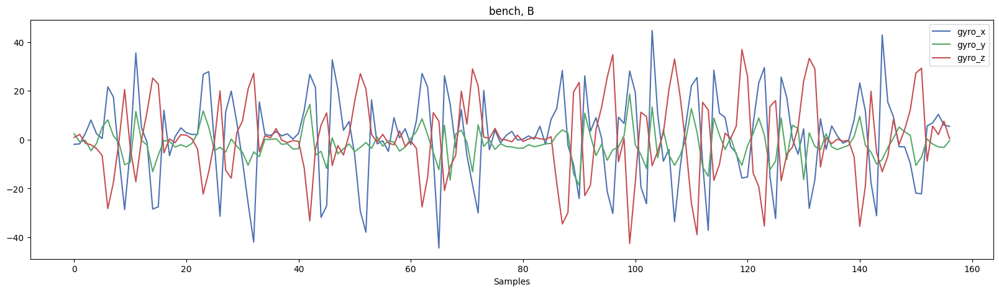

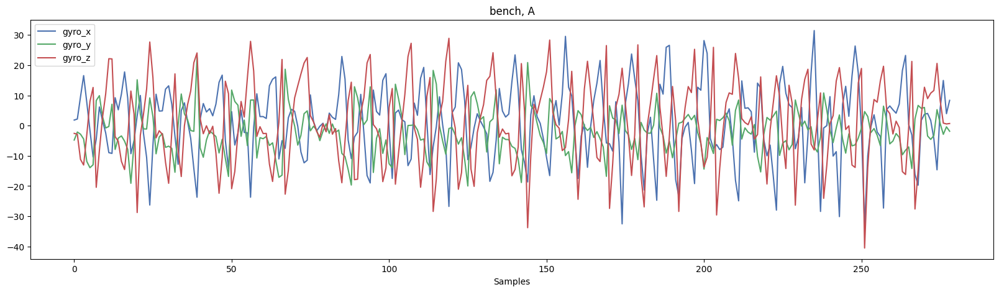

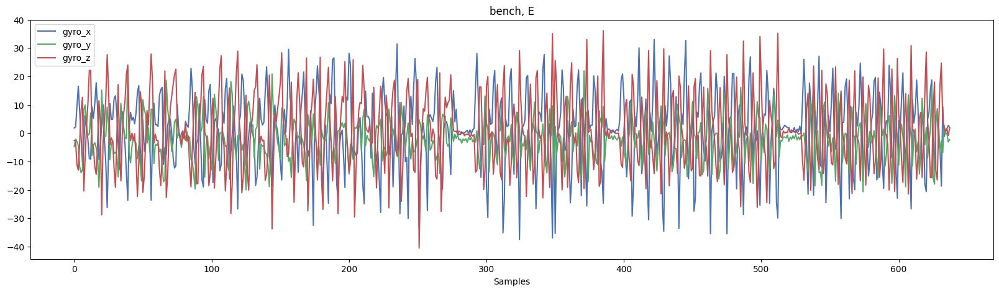

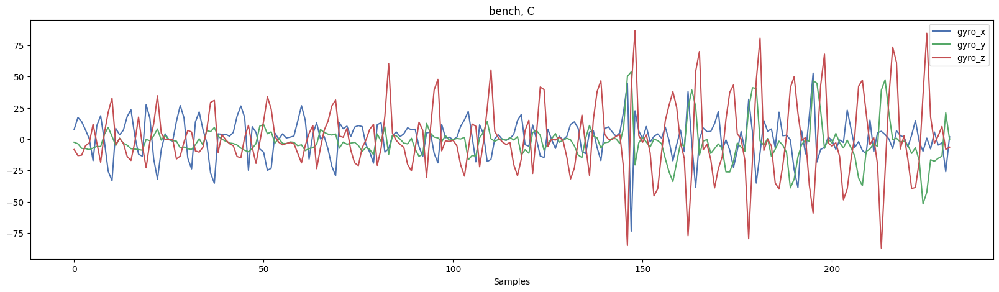

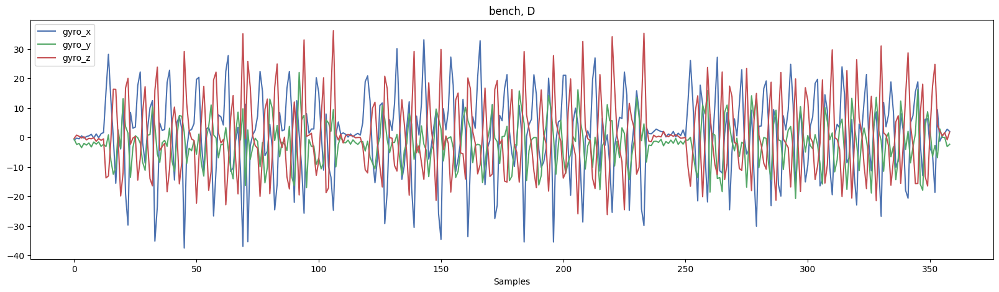

...

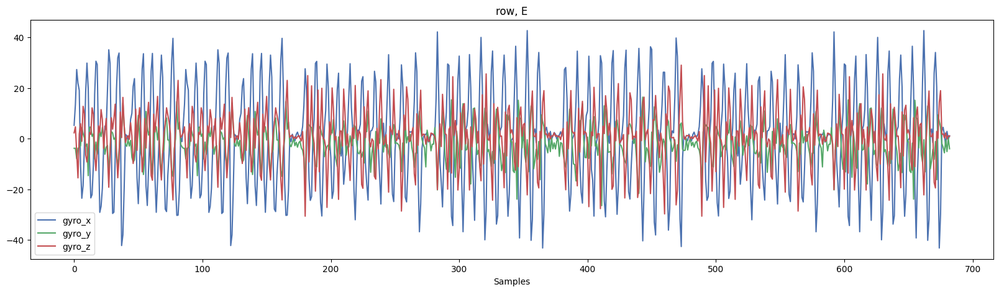

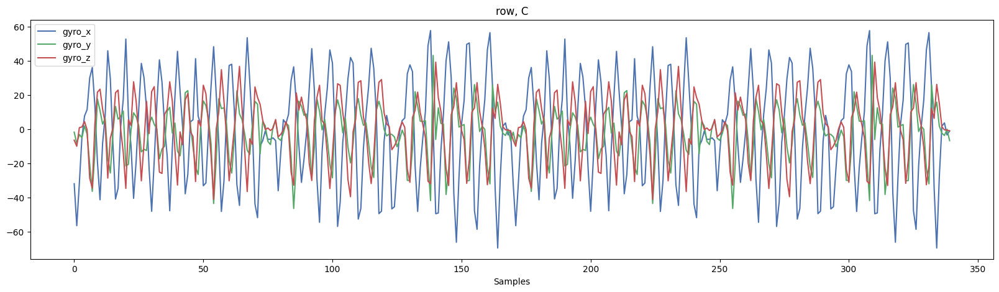

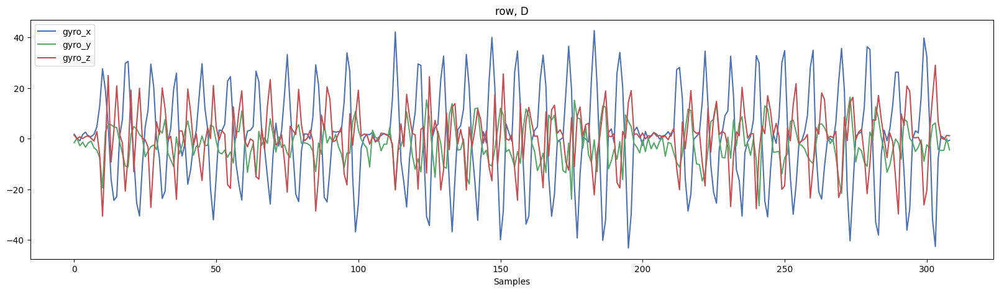

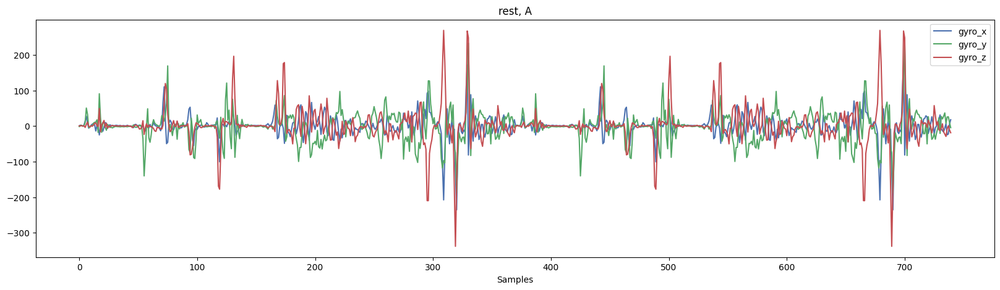

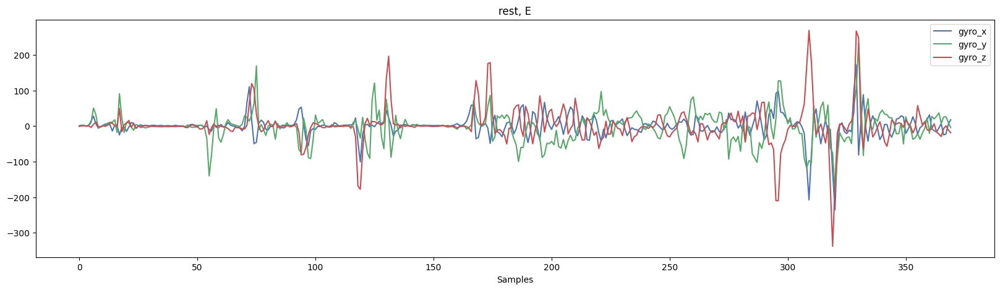

In [99]:
for excercise in excercises:
  for participant in participants:
    query_df = df.query(f"excercise == '{excercise}'").query(f"participant =='{participant}'").reset_index()
    if len(query_df) > 0:
      query_df[["gyro_x","gyro_y","gyro_z"]].plot()
      plt.xlabel("Samples")
      plt.legend()
      plt.title(f"{excercise}, {participant}")
      plt.show()

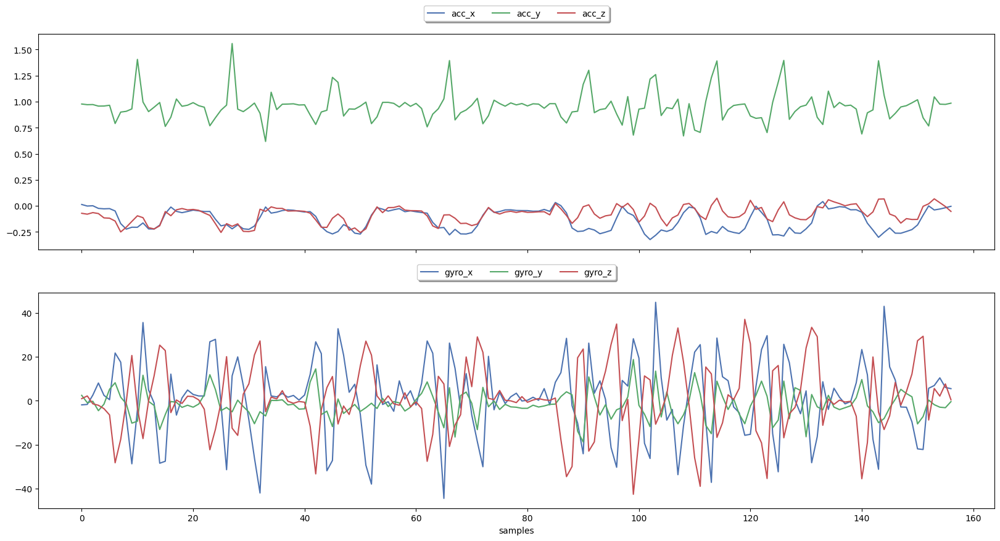

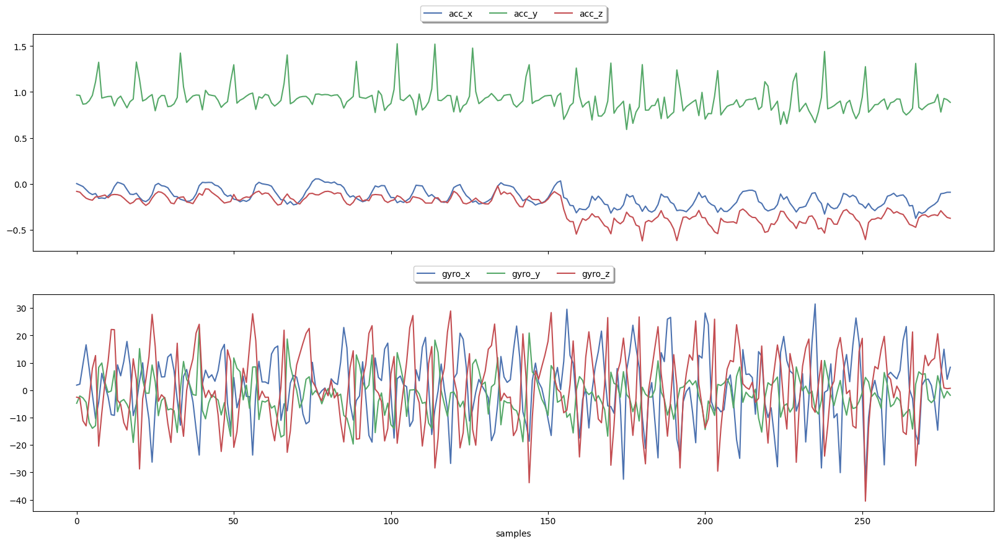

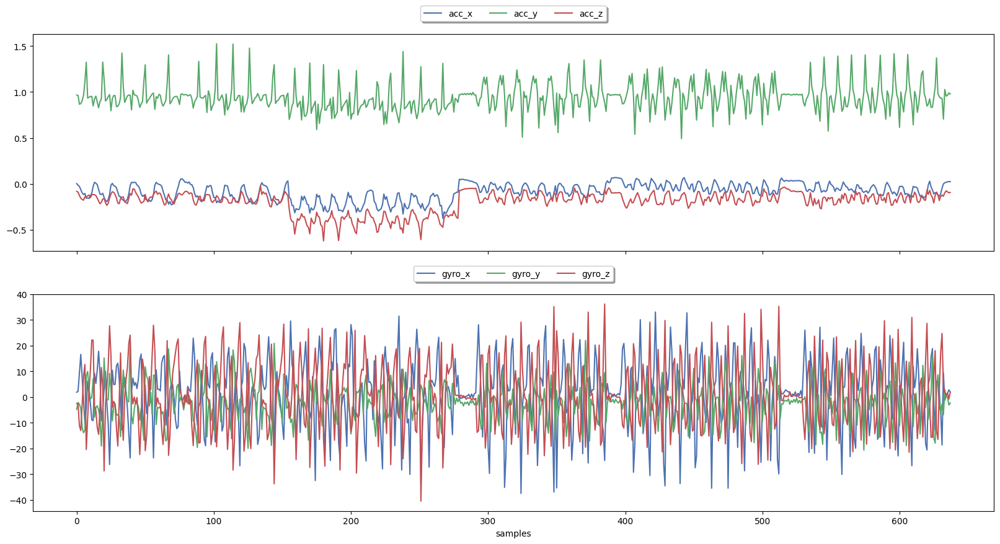

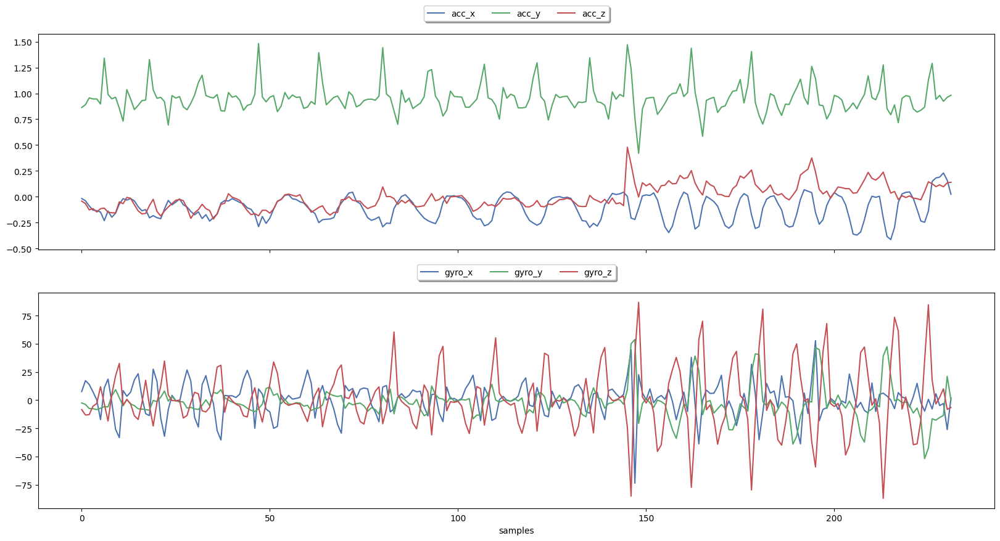

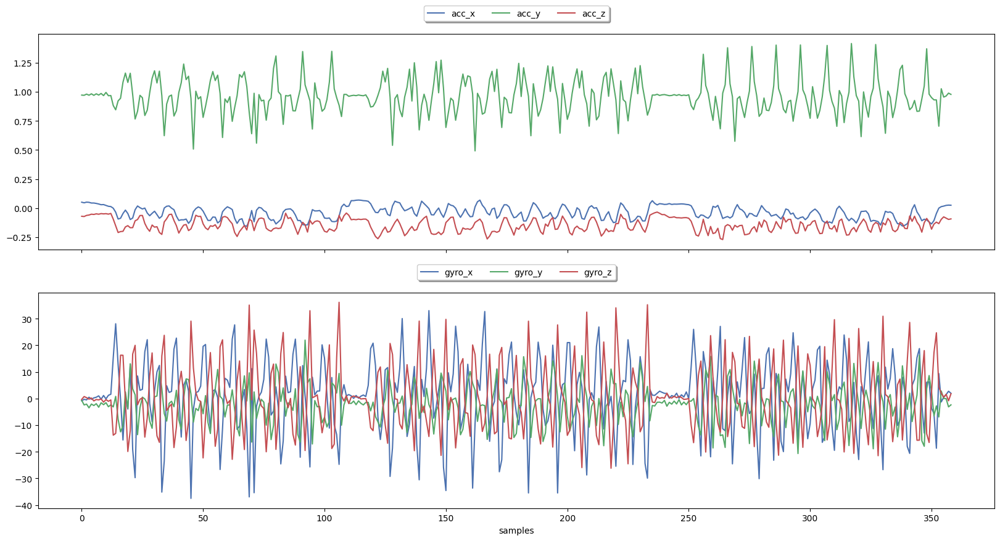

...

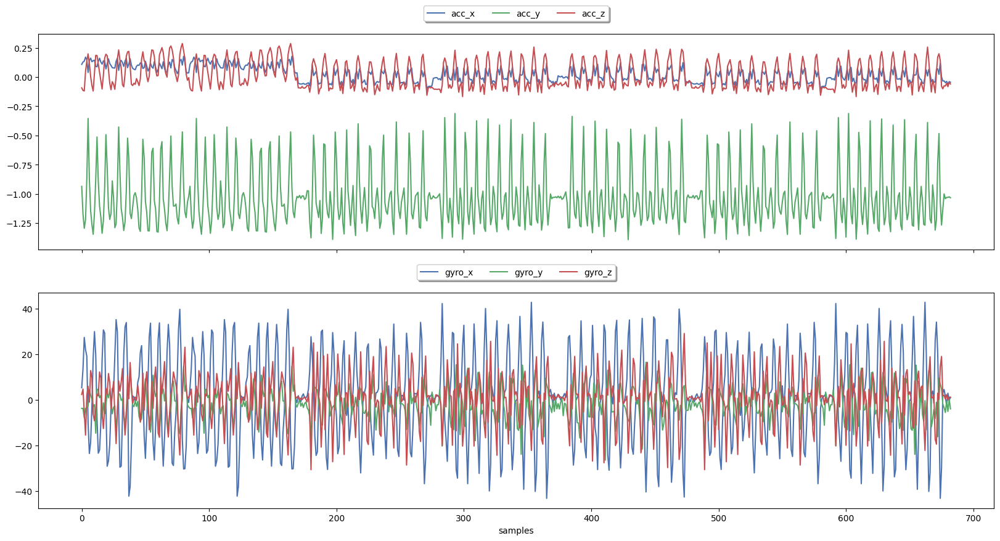

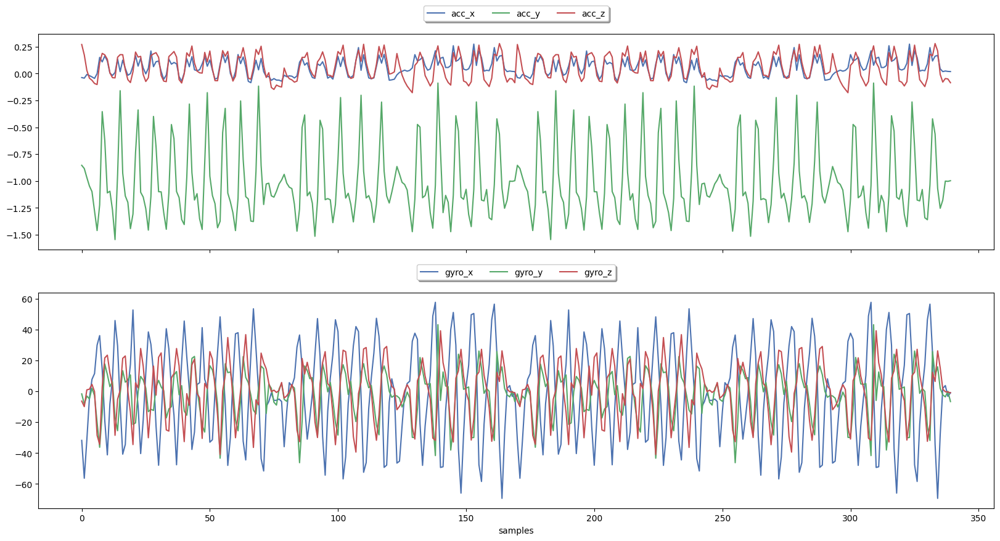

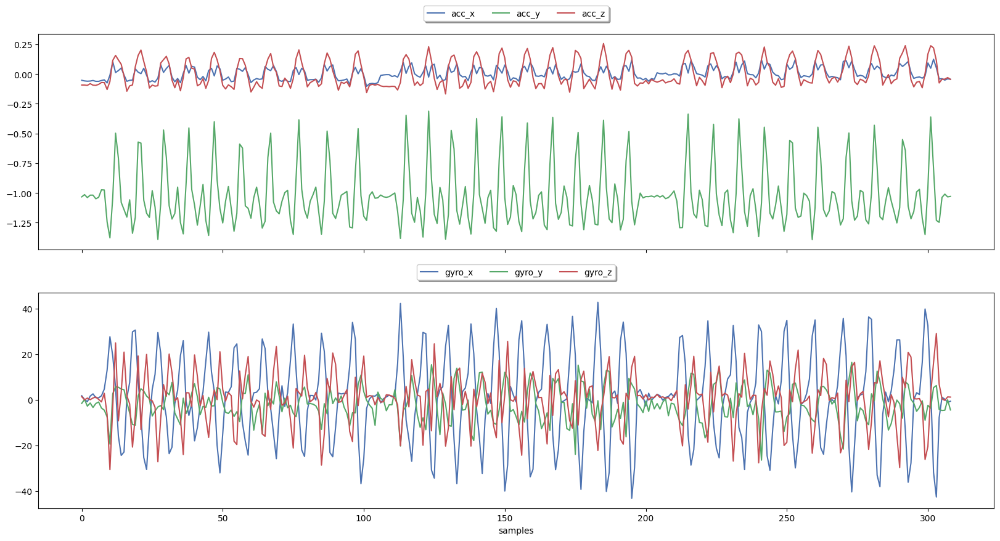

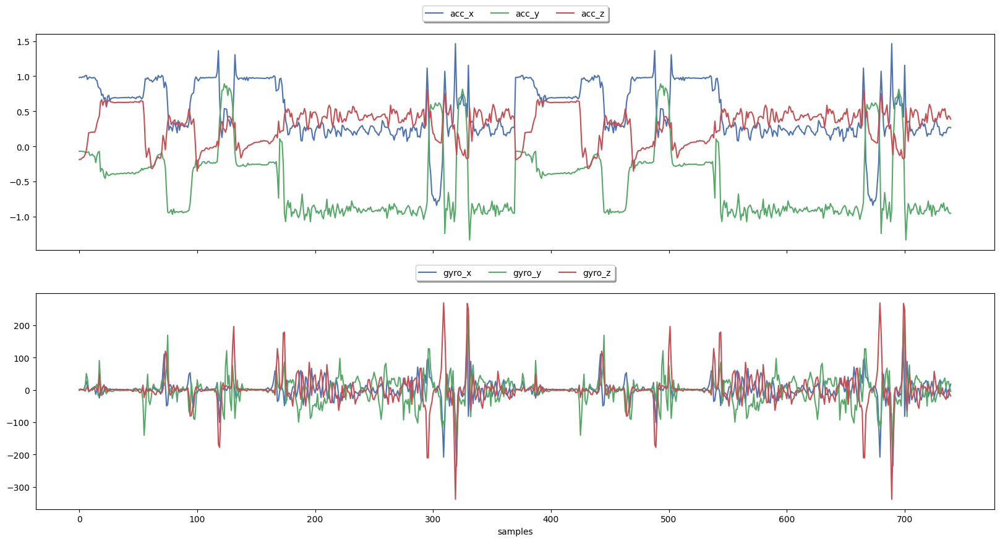

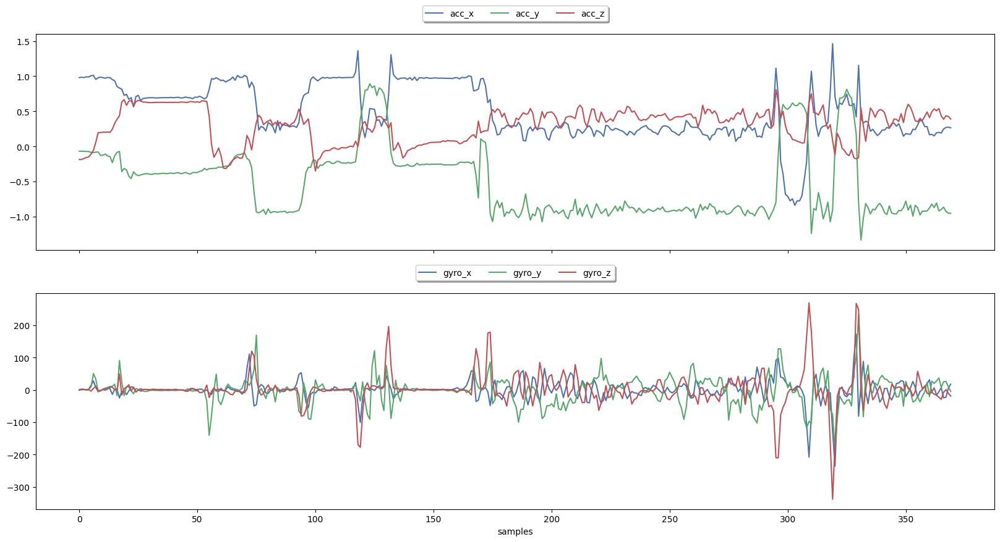

In [16]:
# --------------------------------------------------------------
# Combine plots in one figure
# --------------------------------------------------------------
excercises = df.excercise.unique()
participants = df.participant.unique()

for excercise in excercises:
  for participant in participants:
    query_df = df.query(f"excercise == '{excercise}'").query(f"participant =='{participant}'").reset_index(drop = True)

    if len(query_df) > 0:
      fig, ax = plt.subplots(nrows = 2, sharex = True, figsize = [20, 10])
      query_df[["acc_x","acc_y","acc_z"]].plot(ax = ax[0])
      query_df[["gyro_x","gyro_y","gyro_z"]].plot(ax = ax[1])

      ax[0].legend(loc="upper center", bbox_to_anchor=(0.5, 1.15), ncol=3, fancybox=True, shadow=True)
      ax[1].legend(loc="upper center", bbox_to_anchor= (0.5, 1.15), ncol=3, fancybox=True, shadow=True)
      ax[1].set_xlabel("samples")

      plt.savefig(f"../../../reports/figures/{excercise}_{[participant]}.png")
      plt.show()